In [1]:
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

In [217]:
ROOT = 'data'
def read_image_from_path(path, size):
  im = Image.open(path).convert('RGB').resize(size)
  return np.array(im).astype(np.float32)

def folder_of_images(folder, size):
  list_dir = [folder + '/' + filename for filename in os.listdir(folder)]
  images_np = []
  images_path = []
  for path in list_dir:
    images_np.append(read_image_from_path(path, size))
    images_path.append(path)
  images_np = np.array(images_np)
  images_path = np.array(images_path)
  return images_np, images_path

In [218]:
read_image_from_path('/content/bird1.jpg', (256, 256))

array([[[ 90., 120., 157.],
        [ 91., 119., 157.],
        [ 91., 120., 157.],
        ...,
        [104., 112., 147.],
        [106., 115., 147.],
        [107., 116., 148.]],

       [[ 67., 102., 143.],
        [ 68., 102., 143.],
        [ 68., 102., 143.],
        ...,
        [ 81.,  93., 131.],
        [ 84.,  95., 131.],
        [ 87.,  96., 133.]],

       [[ 71., 103., 144.],
        [ 72., 104., 145.],
        [ 71., 104., 145.],
        ...,
        [ 82.,  95., 131.],
        [ 84.,  97., 132.],
        [ 87.,  97., 133.]],

       ...,

       [[251., 238., 236.],
        [251., 236., 237.],
        [249., 235., 233.],
        ...,
        [ 84.,  92., 130.],
        [ 83.,  91., 130.],
        [ 82.,  90., 129.]],

       [[249., 231., 231.],
        [249., 229., 227.],
        [249., 227., 227.],
        ...,
        [ 84.,  92., 131.],
        [ 83.,  91., 130.],
        [ 82.,  90., 129.]],

       [[248., 227., 230.],
        [250., 226., 227.],
        [249., 2

## Truy vấn với L1

In [219]:
def absolute_difference(query, data):
  #sum across batch dim (0)
  return np.sum(np.abs(query - data), axis=tuple(range(1, len(data.shape))))

In [220]:
def get_l1_score(query_path, images_path, size):
  query = read_image_from_path(query_path, size)
  images, paths = folder_of_images(images_path, size)
  scores = absolute_difference(query, images)
  path_score = list(zip(paths, scores))
  return path_score

In [241]:
import math
def plot_results(path_score, query_path='/content/bird1.jpg', images_per_row=5, reverse=False):
    path_score = sorted(path_score, key=lambda x: x[1], reverse=reverse)
    num_images = len(path_score) + 1
    num_rows = math.ceil(num_images / images_per_row)

    fig, axes = plt.subplots(num_rows, images_per_row, figsize=(15, num_rows * 5))
    axes = axes.flatten()

    query_img = Image.open(query_path)
    axes[0].imshow(query_img)
    axes[0].axis('off')
    axes[0].set_title('Query Image')

    for i, (path, score) in enumerate(path_score):
        img = Image.open(path)
        ax = axes[i + 1]
        ax.imshow(img)
        ax.axis('off')
        ax.set_title(f'Top {i + 1}\nScore: {score}')

    # Hide any remaining axes
    for j in range(len(path_score) + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

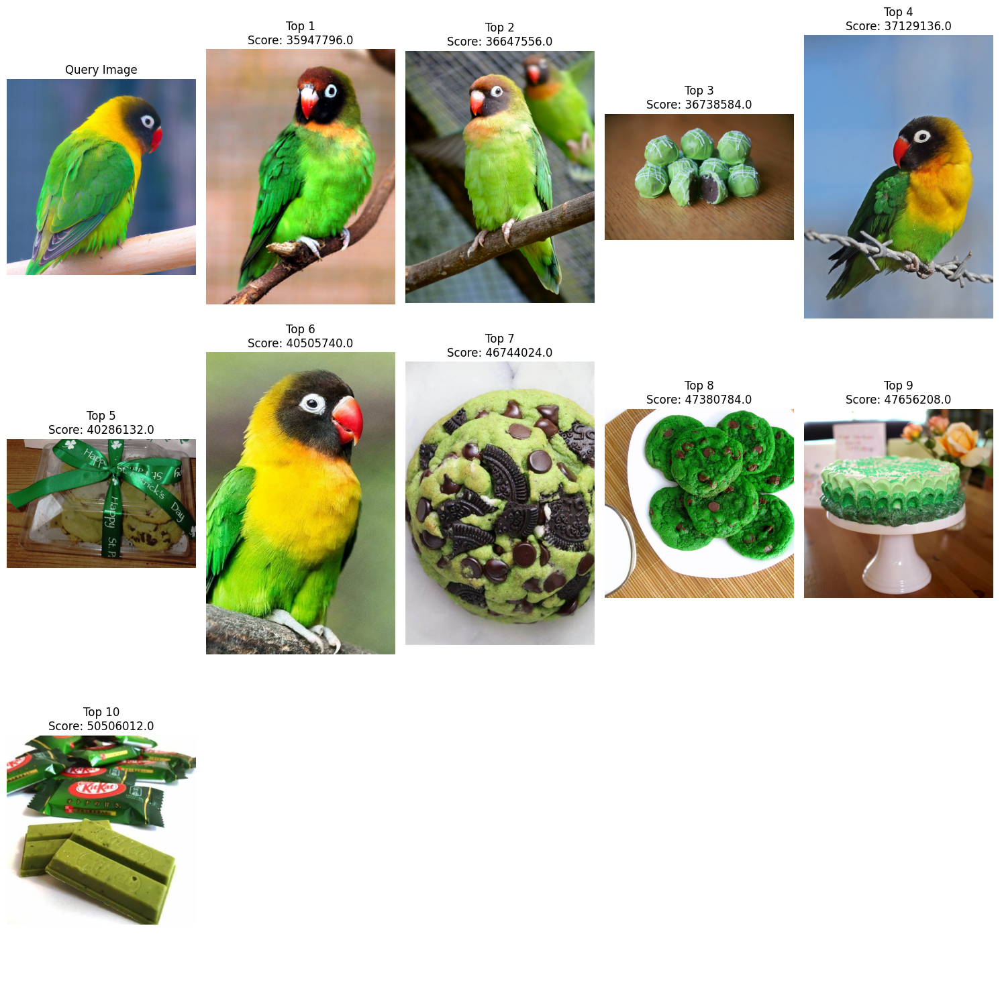

In [242]:
SIZE = (448, 448)
query_path = '/content/bird1.jpg'
images_paths = '/content/data1'
path_score = get_l1_score(query_path, images_paths, SIZE)
plot_results(path_score)

In [243]:
!rm -r /content/data1/.ipynb_checkpoints

rm: cannot remove '/content/data1/.ipynb_checkpoints': No such file or directory


## L2 score

In [328]:
def mean_sqared_difference(query, data):
  axis_batch = tuple(range(1, len(data.shape)))
  return np.sqrt(np.sum((query - data)**2, axis=axis_batch))

In [329]:
def get_l2_score(query_path, images_path, size):
  query = read_image_from_path(query_path, size)
  images, paths = folder_of_images(images_path, size)
  scores = mean_sqared_difference(query, images)
  path_score = list(zip(paths, scores))
  return path_score

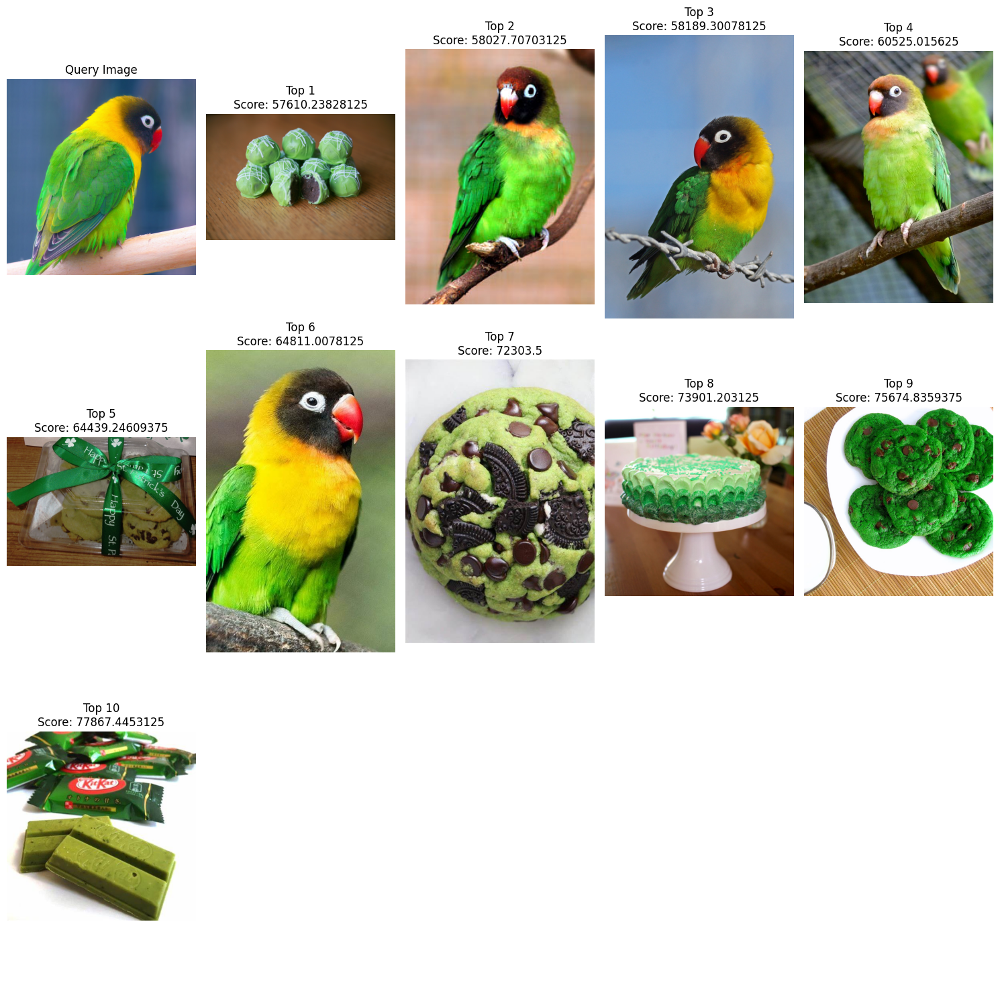

In [330]:
SIZE = (448, 448)
query_path = '/content/bird1.jpg'
images_paths = '/content/data1'
path_score = get_l2_score(query_path, images_paths, SIZE)
plot_results(path_score)

## Cosine similarity

In [247]:
def cosine_similarity(query, data):
  axis_batch = tuple(range(1, len(data.shape)))
  query_norm = np.sqrt(np.sum(query**2))
  data_norm = np.sqrt(np.sum(data**2, axis=axis_batch))
  dot = np.sum(query * data, axis=axis_batch)
  res = dot / (query_norm * data_norm + np.finfo(np.float32).eps)
  return res

In [248]:
def get_consine_similarity_score(query_path, images_path, size):
  query = read_image_from_path(query_path, size)
  images, paths = folder_of_images(images_path, size)
  scores = cosine_similarity(query, images)
  path_score = list(zip(paths, scores))
  return path_score

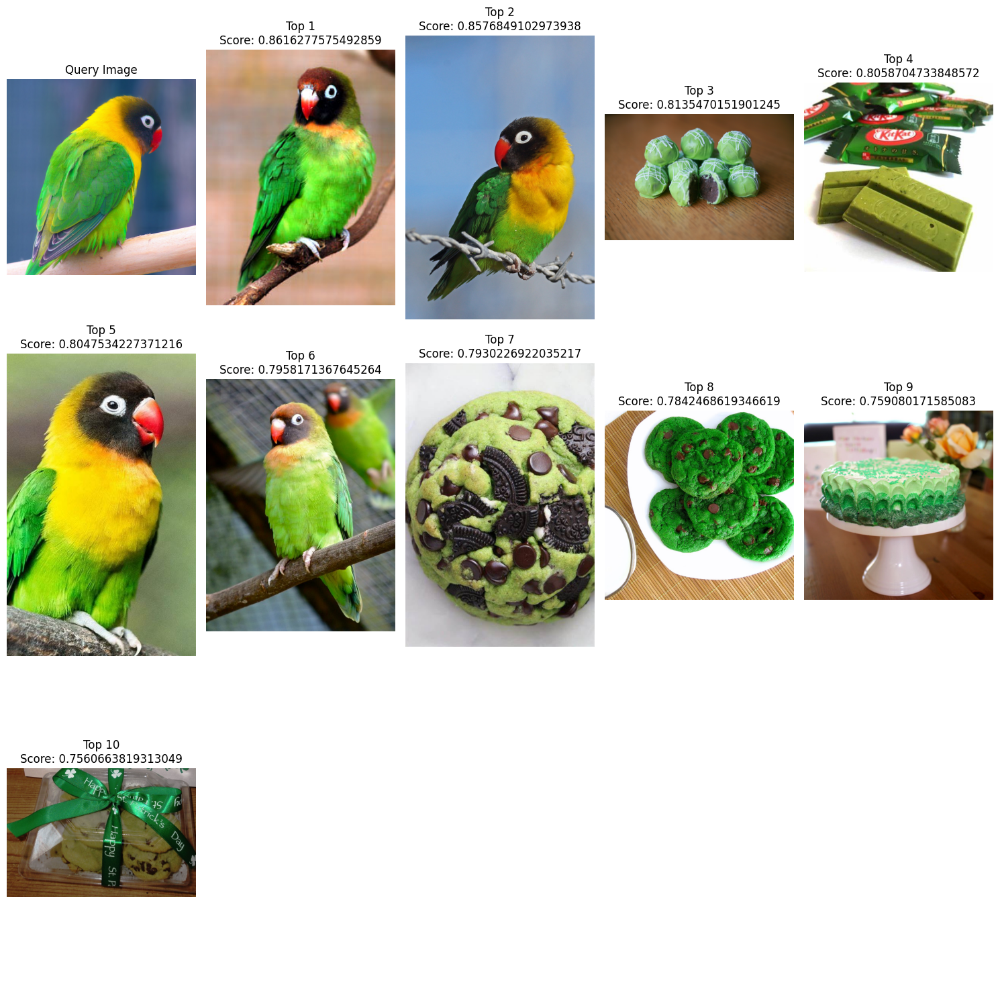

In [249]:
SIZE = (448, 448)
query_path = '/content/bird1.jpg'
images_paths = '/content/data1'
path_score = get_consine_similarity_score(query_path, images_paths, SIZE)
plot_results(path_score, reverse=True)

## Correlation coef

In [250]:
def correlation_coefficient(query, data):
  axis_batch = tuple(range(1, len(data.shape)))
  query_mean = query - np.mean(query)
  data_mean = data - np.mean(data, axis=axis_batch, keepdims=True)
  query_std = np.sqrt(np.sum(query_mean**2))
  data_std = np.sqrt(np.sum(data_mean**2, axis=axis_batch))
  dot = np.sum(query_mean * data_mean, axis=axis_batch)
  res = dot / (query_std * data_std + np.finfo(np.float32).eps)
  return res

In [284]:
def get_correlation_coefficient(query_path, images_path, size):
  query = read_image_from_path(query_path, size)
  images, paths = folder_of_images(images_path, size)
  scores = correlation_coefficient(query, images)
  path_score = list(zip(paths, scores))
  return path_score

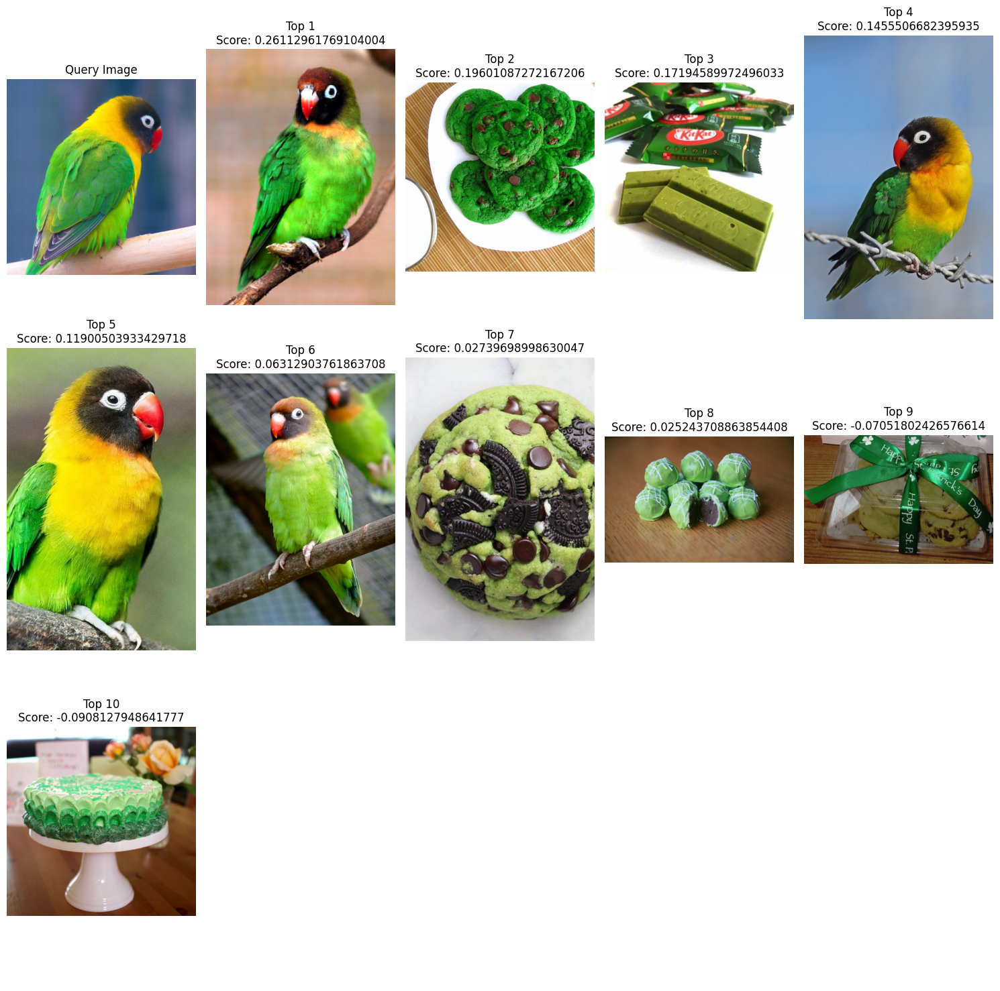

In [286]:
SIZE = (448, 448)
query_path = '/content/bird1.jpg'
images_paths = '/content/data1'
path_score = get_correlation_coefficient(query_path, images_paths, SIZE)
plot_results(path_score, reverse=True)

## Deep learning

In [253]:
%pip install chromadb
%pip install open-clip-torch

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.3/67.3 kB 4.8 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.4/50.4 kB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 584.3/584.3 kB 18.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 42.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 273.8/273.8 kB 14.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.1/93.1 kB 6.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.6/75.6 kB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.9/77.9 kB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 38.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.6/67.6 kB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.8/6.8 MB 35.1 MB/s eta 0:00:00


In [258]:
from chromadb.utils.embedding_functions import OpenCLIPEmbeddingFunction # type: ignore
import open_clip # type: ignore
import torch

In [263]:
embedding_function = OpenCLIPEmbeddingFunction()
def get_single_image_embedding(image):
  embedding = embedding_function._encode_image(image)
  return np.array(embedding)

In [303]:
def get_score(query_path, images_path, size, score_function):
  query = read_image_from_path(query_path, size)
  query_embedding = get_single_image_embedding(query.astype(np.uint8))
  images, paths = folder_of_images(images_path, size)
  images_embedding = []
  for i in range(images.shape[0]):
    images_embedding.append(get_single_image_embedding(images[i].astype(np.uint8)))
  images_embedding = np.array(images_embedding)
  scores = score_function(query_embedding, images_embedding)
  path_score = list(zip(paths, scores))
  return path_score

## L1

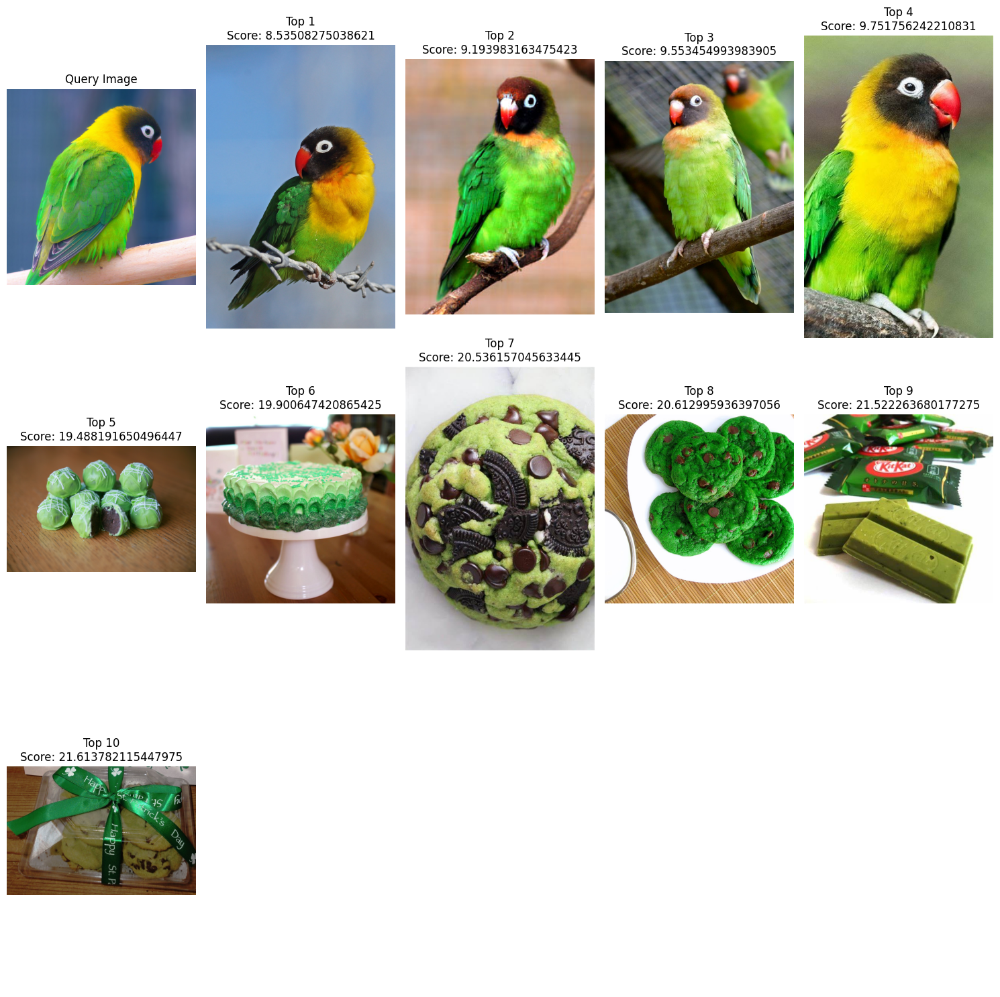

In [287]:
SIZE = (448, 448)
query_path = '/content/bird1.jpg'
images_paths = '/content/data1'
path_score = get_score(query_path, images_paths, SIZE, absolute_difference)
plot_results(path_score)

## MSE

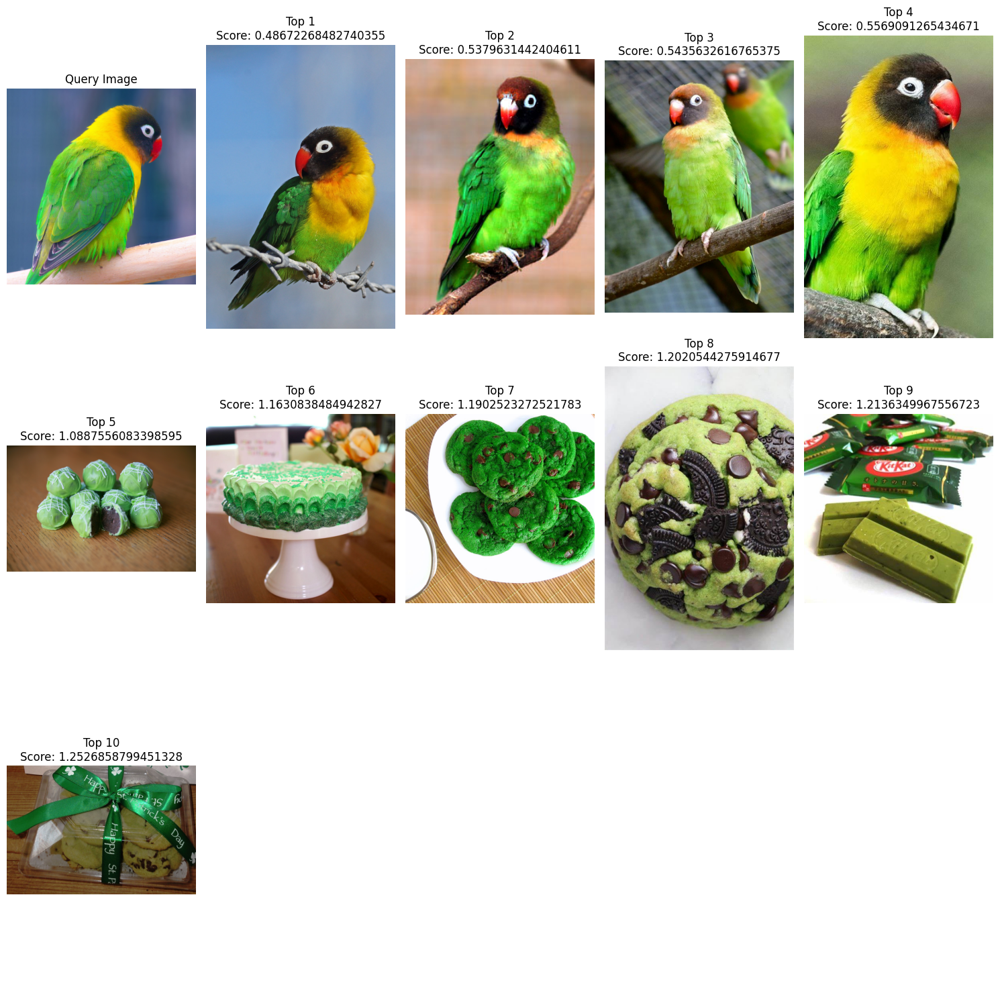

In [331]:
path_score = get_score(query_path, images_paths, SIZE, mean_sqared_difference)
plot_results(path_score)

## Cosine similarity

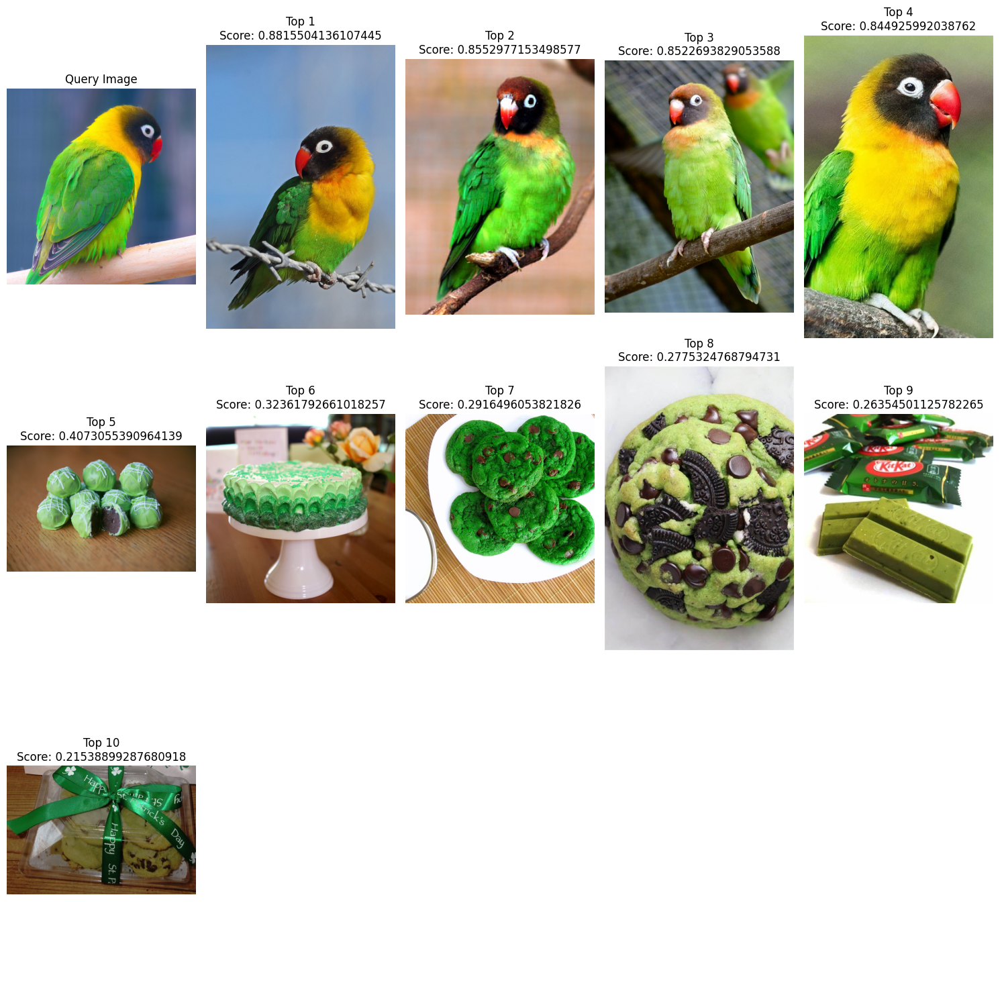

In [290]:
path_score = get_score(query_path, images_paths, SIZE, cosine_similarity)
plot_results(path_score, reverse=True)

## Correlation Coeff

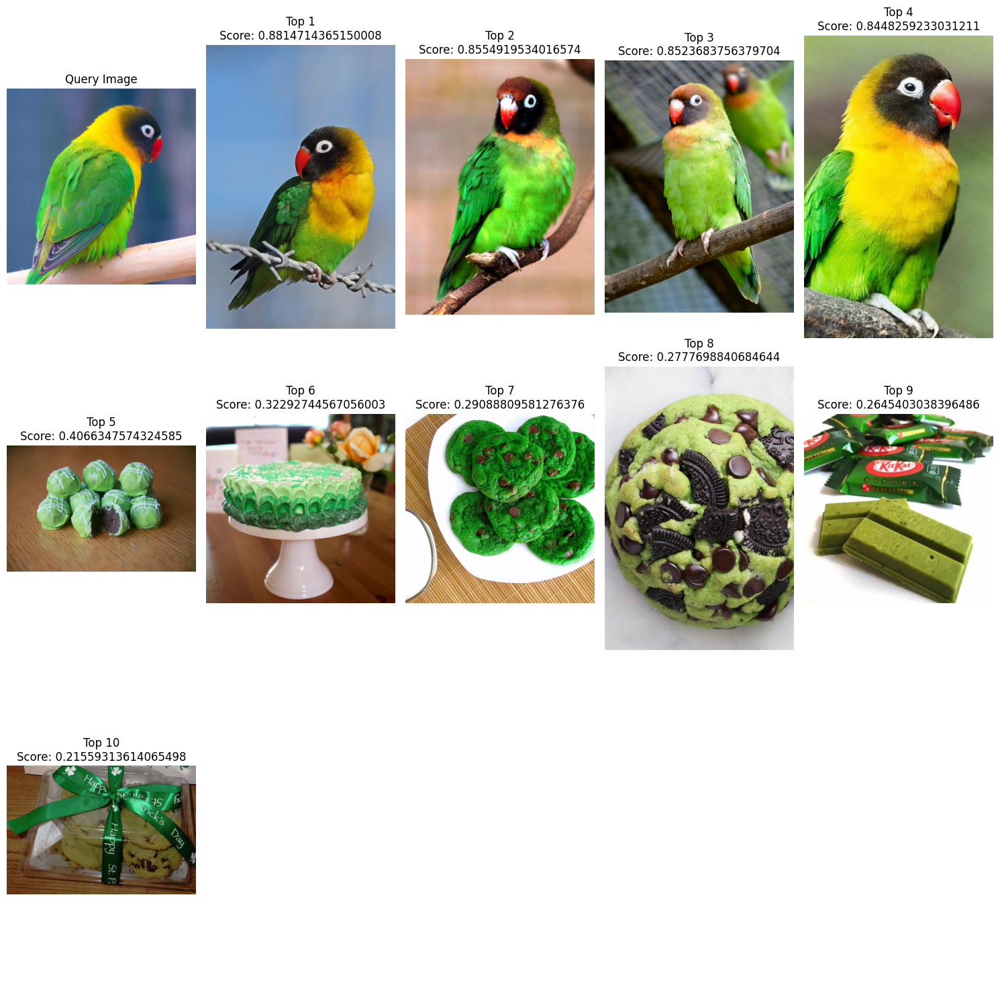

In [291]:
path_score = get_score(query_path, images_paths, SIZE, correlation_coefficient)
plot_results(path_score, reverse=True)

# Indexing with Chromadb

In [306]:
from tqdm import tqdm
import io
def add_embedding(collection, file_paths):
  ids = []
  embeddings = []
  for i, filepath in tqdm(enumerate(file_paths)):
    image = read_image_from_path(filepath, (448, 448)).astype(np.uint8)
    embedding = get_single_image_embedding(image)
    embeddings.append(embedding.tolist())
    ids.append(f"id_{i}")
  collection.add(
      embeddings=embeddings,
      ids=ids,
  )

In [307]:
import chromadb # type: ignore
DATA_ROOT = '/content/data1'
file_paths = [DATA_ROOT + '/' + filename for filename in os.listdir(DATA_ROOT)]
chroma_client = chromadb.Client()
l2_collection = chroma_client.get_or_create_collection(name="l2_collection")
add_embedding(l2_collection, file_paths)

10it [00:02,  3.48it/s]


In [311]:
id2path = {}
for i, path in enumerate(file_paths):
  id2path[f"id_{i}"] = path

In [308]:
def search(collection, query_path, size, n_results=6):
  query = read_image_from_path(query_path, size)
  query_embedding = get_single_image_embedding(query.astype(np.uint8))
  results = collection.query(
      query_embeddings=query_embedding.tolist(),
      n_results=n_results,
  )
  return results

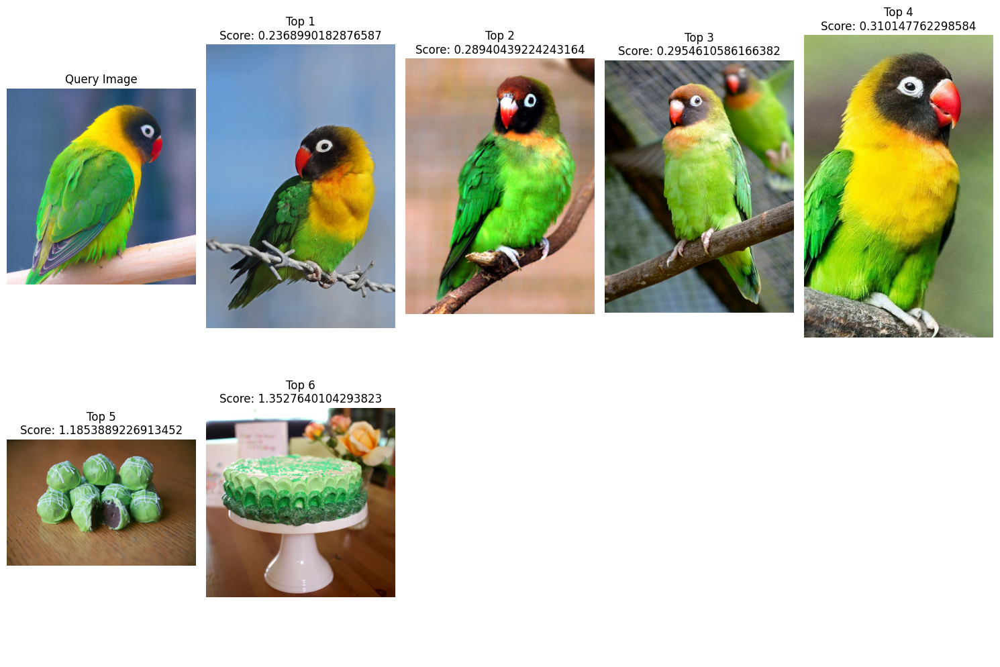

In [312]:
SIZE = (448, 448)
query_path = '/content/bird1.jpg'
results = search(l2_collection, query_path, SIZE)
ids = results['ids'][0]
paths = [id2path[id] for id in ids]
scores = results['distances'][0]
path_score = list(zip(paths, scores))
plot_results(path_score)


In [320]:
cosine_collection = chroma_client.get_or_create_collection(name="cosine_collection", metadata={
    "hnsw:space": "cosine"})
add_embedding(cosine_collection, file_paths)

10it [00:04,  2.47it/s]


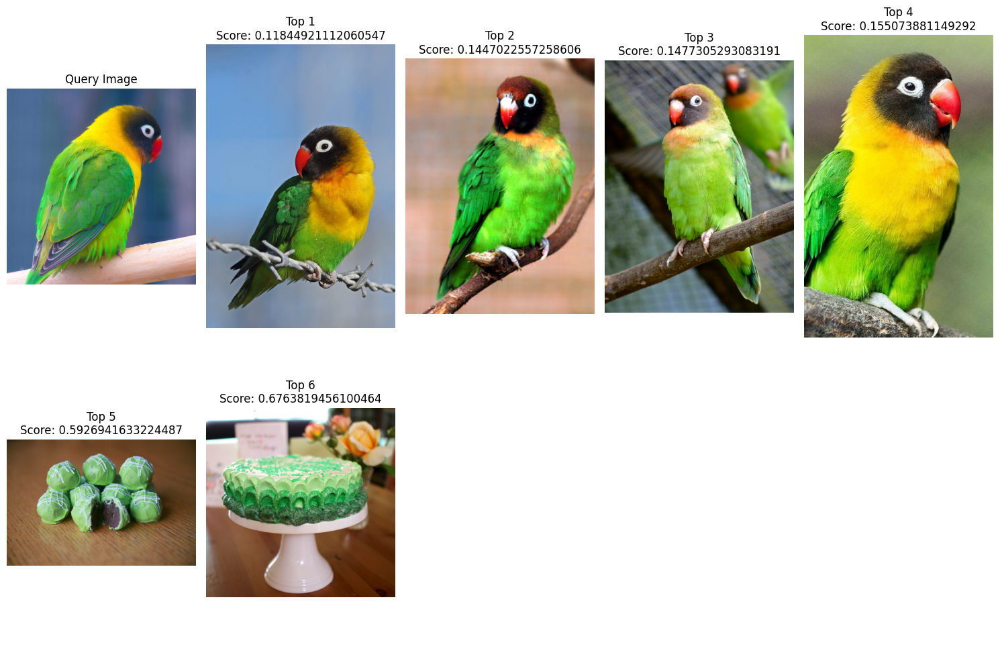

In [322]:
results = search(cosine_collection, query_path, SIZE)
ids = results['ids'][0]
paths = [id2path[id] for id in ids]
scores = results['distances'][0]
path_score = list(zip(paths, scores))
plot_results(path_score)

In [326]:
a = np.array([1, 2, 3])
b = np.array([4, 5, 6])
b = b[None, :]
absolute_difference(a, b)

array([9])

In [333]:
mean_sqared_difference(a, b)**2

array([27.])

In [334]:
a = np.array([1,0,1])
b = np.array([0,1,0])
b = b[None, :]
cosine_similarity(a, b)

array([0.])

In [335]:
a = np.array([2,4])
b = np.array([1,2])
b = b[None, :]
correlation_coefficient(a, b)

array([0.99999988])

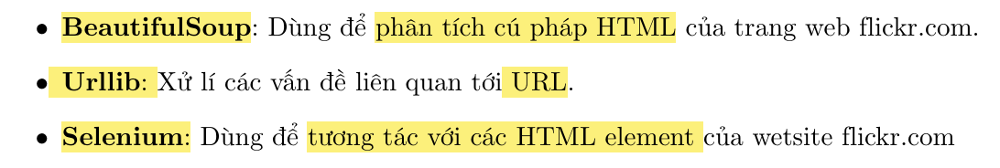

In [1]:
# Install necessary packages
%pip install selenium
%apt-get install -y chromium-browser
%apt-get install -y chromium-chromedriver

# Import necessary modules
from selenium import webdriver # type: ignore
from selenium.webdriver.common.by import By # type: ignore
from selenium.webdriver.support.ui import WebDriverWait # type: ignore
from selenium.webdriver.support import expected_conditions as EC # type: ignore

from bs4 import BeautifulSoup  # For parsing HTML content
from urllib.parse import urljoin, urlparse  # For handling URLs
import urllib.request  # For making HTTP requests
import time  # For handling time-related operations
import os  # For interacting with the operating system (directories, folders, files)
from tqdm import tqdm  # For displaying progress bars (visualize progress)
import concurrent.futures  # For multi-threading
import json  # For writing to a text file
from PIL import Image  # For handling images

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.4/9.4 MB 81.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 475.7/475.7 kB 31.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/58.3 kB 5.5 MB/s eta 0:00:00
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  apparmor libfuse3-3 liblzo2-2 libudev1 snapd squashfs-tools systemd-hwe-hwdb udev
Suggested packages:
  apparmor-profiles-extra apparmor-utils fuse3 zenity | kdialog
The following NEW packages will be installed:
  apparmor chromium-browser libfuse3-3 liblzo2-2 snapd squashfs-tools systemd-hwe-hwdb udev
The following packages will be upgraded:
  libudev1
1 upgraded, 8 newly installed, 0 to remove and 44 not upgraded.
Need to get 28.4 MB of archives.
After this operation, 117 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy-updates/main amd64 apparmor amd64 3.0.4-2ubunt

In [11]:
class UrlScraper:
  def __init__(self, url_template, max_images=50, max_workers=4):
    self.url_template = url_template
    self.max_images = max_images
    self.max_workers = max_workers
    self.driver = self.setup_env()
  def setup_env(self):
    os.environ['PATH'] += ':/usr/lib/chromium-browser'
    os.environ['PATH'] += ':/usr/lib/chromium-browser/chromedriver'

  def get_url_images(self, term):
    """
    Crawl the URLs of images by term.

    Parameters:
    term (str): The name of the animal, plant, scenery, furniture

    Returns:
    list: List of URLs of images
    """
    # Initialize Chrome driver
    options = webdriver.ChromeOptions()
    options.add_argument('--headless')
    options.add_argument('--no-sandbox')
    options.add_argument('--disable-dev-shm-usage')
    driver = webdriver.Chrome(options=options)

    url = self.url_template.format(search_term=term)
    driver.get(url)

    # Start crawling URLs of images
    urls = []
    more_content_available = True

    pbar = tqdm(total=self.max_images, desc=f"Fetching images for {term}")  # Set up for visualizing progress

    while len(urls) < self.max_images and more_content_available:
        soup = BeautifulSoup(driver.page_source, "html.parser")
        img_tags = soup.find_all("img")

        for img in img_tags:
            if len(urls) >= self.max_images:
                break
            if 'src' in img.attrs:
                href = img.attrs['src']
                img_path = urljoin(url, href)
                img_path = img_path.replace("_m.jpg", "_b.jpg").replace("_n.jpg", "_b.jpg").replace("_w.jpg", "_b.jpg")
                if img_path == "https://combo.staticflickr.com/ap/build/images/getty/IStock_corporate_logo.svg":
                    continue
                urls.append(img_path)
                pbar.update(1)

        try:
            load_more_button = WebDriverWait(driver, 10).until(
                EC.element_to_be_clickable((By.XPATH, '//button[@id="yui_3_16_0_1_1721642285931_28620"]'))
            )
            load_more_button.click()
            time.sleep(2)
        except:
            driver.execute_script("window.scrollTo(0, document.body.scrollHeight);")
            time.sleep(2)

        new_soup = BeautifulSoup(driver.page_source, "html.parser")
        new_img_tags = new_soup.find_all("img", loading_="lazy")
        if len(new_img_tags) == len(img_tags):
            more_content_available = False
        img_tags = new_img_tags

    pbar.close()
    driver.quit()
    return urls
  def scrape_urls(self, categories):
    """
    Call get_url_images method to get all URLs of any object in categories.

    Parameters:
    categories (dictionary): The dictionary of all objects we need to collect images with format
    categories{"name_object": [value1, value2, ...]}

    Returns:
    all_urls (dictionary): Dictionary of URLs of images
    """
    all_urls = {category: {} for category in categories}

    # Handle multi-threading for efficient scraping
    with concurrent.futures.ThreadPoolExecutor(max_workers=self.max_workers) as executor:
        future_to_term = {
            executor.submit(self.get_url_images, term): (category, term)
            for category, terms in categories.items()
            for term in terms
        }

        for future in tqdm(concurrent.futures.as_completed(future_to_term), total=len(future_to_term), desc="Overall Progress"):
            category, term = future_to_term[future]
            try:
                urls = future.result()
                all_urls[category][term] = urls
                print(f"\nNumber of images retrieved for {term}: {len(urls)}")
            except Exception as exc:
                print(f"\n{term} generated an exception: {exc}")

    return all_urls


  def save_to_file(self, data, filename):
    """
    Save the data to a JSON file.

    Parameters:
    data (dict): The data to be saved.
    filename (str): The name of the JSON file.

    Returns:
    None
    """
    with open(filename, 'w') as file:
        json.dump(data, file, indent=4)
    print(f"Data saved to {filename}")



In [12]:
categories = {
    "animal": [
        "Monkey", "Elephant", "cows", "Cat", "Dog", "bear", "fox", "Civet", "Pangolins", "Rabbit", "Bats", "Whale",
        "Cock", "Owl", "flamingo", "Lizard", "Turtle", "Snake", "Frog", "Fish", "shrimp", "Crab", "Snail", "Coral",
        "Jellyfish", "Butterfly", "Flies", "Mosquito", "Ants", "Cockroaches", "Spider", "scorpion", "tiger", "bird",
        "horse", "pig", "Alligator", "Alpaca", "Anteater", "donkey", "Bee", "Buffalo", "Camel", "Caterpillar", "Cheetah",
        "Chicken", "Dragonfly", "Duck", "panda", "Giraffe"
    ],
    "plant": [
        "Bamboo", "Apple", "Apricot", "Banana", "Bean", "Wildflower", "Flower", "Mushroom", "Weed", "Fern", "Reed",
        "Shrub", "Moss", "Grass", "Palmtree", "Corn", "Tulip", "Rose", "Clove", "Dogwood", "Durian", "Ferns", "Fig",
        "Flax", "Frangipani", "Lantana", "Hibiscus", "Bougainvillea", "Pea", "OrchidTree", "RangoonCreeper", "Jackfruit",
        "Cottonplant", "Corneliantree", "Coffeeplant", "Coconut", "wheat", "watermelon", "radish", "carrot"
    ],
    "furniture": [
        "bed", "cabinet", "chair", "chests", "clock", "desks", "table", "Piano", "Bookcase", "Umbrella", "Clothes",
        "cart", "sofa", "ball", "spoon", "Bowl", "fridge", "pan", "book"
    ],
    "scenery": [
        "Cliff", "Bay", "Coast", "Mountains", "Forests", "Waterbodies", "Lake", "desert", "farmland", "river", "hedges",
        "plain", "sky", "cave", "cloud", "flowergarden", "glacier", "grassland", "horizon", "lighthouse", "plateau",
        "savannah", "valley", "volcano", "waterfall"
    ]
}

urltopic = {"flickr": "https://www.flickr.com/search/?text={search_term}"}

In [13]:
scraper = UrlScraper(url_template=urltopic["flickr"], max_images=20, max_workers=5)
image_urls = scraper.scrape_urls(categories)
scraper.save_to_file(image_urls, 'image_urls.json')

Fetching images for Cat:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for cows:   0%|          | 0/20 [00:00<?, ?it/s]

Fetching images for Monkey:   0%|          | 0/20 [00:00<?, ?it/s]



Fetching images for Cat:   5%|▌         | 1/20 [00:03<01:03,  3.34s/it]




Fetching images for Elephant:   0%|          | 0/20 [00:00<?, ?it/s]




Fetching images for Elephant:   5%|▌         | 1/20 [00:02<00:48,  2.55s/it]




Fetching images for Elephant:  10%|█         | 2/20 [00:02<00:23,  1.28s/it]

Fetching images for Monkey:   5%|▌         | 1/20 [00:03<01:02,  3.31s/it]


Fetching images for cows:   5%|▌         | 1/20 [00:04<01:29,  4.70s/it]



Overall Progress:   1%|          | 1/134 [00:25<55:31, 25.05s/it]


Number of images retrieved for Cat: 20


Fetching images for Monkey: 100%|██████████| 20/20 [00:17<00:00,  1.15it/s]


Number of images retrieved for Elephant: 20



Overall Progress:   2%|▏         | 3/134 [00:29<15:24,  7.06s/it]


Number of images retrieved for Monkey: 20


Fetching images for Dog: 100%|██████████| 20/20 [00:19<00:00,  1.00it/s]

Fetching images for cows: 100%|██████████| 20/20 [00:20<00:00,  1.02s/it]



Number of images retrieved for Dog: 20


Overall Progress:   4%|▎         | 5/134 [00:33<08:25,  3.92s/it]


Number of images retrieved for cows: 20



Fetching images for bear:   5%|▌         | 1/20 [00:03<01:06,  3.50s/it]

Fetching images for fox:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for Civet:   0%|          | 0/20 [00:00<?, ?it/s]

Fetching images for fox:   5%|▌         | 1/20 [00:01<00:25,  1.33s/it]


Fetching images for Civet:   5%|▌         | 1/20 [00:02<00:48,  2.54s/it]



Fetching images for Pangolins:   0%|          | 0/20 [00:00<?, ?it/s]




Fetching images for Rabbit:   0%|          | 0/20 [00:00<?, ?it/s]



Fetching images for Pangolins:   5%|▌         | 1/20 [00:02<00:47,  2.48s/it]




Overall Progress:   4%|▍         | 6/134 [00:48<16:29,  7.73s/it]


Number of images retrieved for bear: 20



Overall Progress:   5%|▌         | 7/134 [00:55<15:22,  7.27s/it]


Number of images retrieved for fox: 20


Overall Progress:   6%|▌         | 8/134 [00:56<11:38,  5.54s/it]


Number of images retrieved for Civet: 20




Fetching images for Whale:   0%|          | 0/20 [00:00<?, ?it/s]

Overall Progress:   7%|▋         | 9/134 [01:04<13:03,  6.27s/it]


Number of images retrieved for Rabbit: 20


Overall Progress:   7%|▋         | 10/134 [01:05<09:26,  4.57s/it]


Number of images retrieved for Pangolins: 20





Overall Progress:   8%|▊         | 11/134 [01:07<07:31,  3.67s/it]


Number of images retrieved for Bats: 20





Fetching images for Owl:   0%|          | 0/20 [00:00<?, ?it/s]



Fetching images for flamingo:   0%|          | 0/20 [00:00<?, ?it/s]




Fetching images for Lizard:   0%|          | 0/20 [00:00<?, ?it/s]



Overall Progress:   9%|▉         | 12/134 [01:19<12:51,  6.33s/it]


Number of images retrieved for Whale: 20







Fetching images for Lizard:   5%|▌         | 1/20 [00:02<00:48,  2.56s/it]

Fetching images for Turtle:   0%|          | 0/20 [00:00<?, ?it/s]

Overall Progress:  10%|▉         | 13/134 [01:23<11:00,  5.46s/it]


Number of images retrieved for Cock: 20





Fetching images for Snake:   0%|          | 0/20 [00:00<?, ?it/s]


Overall Progress:  10%|█         | 14/134 [01:31<12:29,  6.25s/it]


Number of images retrieved for flamingo: 20


Overall Progress:  11%|█         | 15/134 [01:32<09:24,  4.74s/it]


Number of images retrieved for Owl: 20


Overall Progress:  12%|█▏        | 16/134 [01:35<08:26,  4.29s/it]


Number of images retrieved for Lizard: 20


Overall Progress:  13%|█▎        | 17/134 [01:40<08:26,  4.33s/it]


Number of images retrieved for Turtle: 20



Overall Progress:  13%|█▎        | 18/134 [01:43<07:42,  3.98s/it]


Number of images retrieved for Snake: 20




Fetching images for Frog:   5%|▌         | 1/20 [00:04<01:15,  3.99s/it]

Fetching images for Fish:   5%|▌         | 1/20 [00:02<00:45,  2.39s/it]


Fetching images for shrimp:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for shrimp:   5%|▌         | 1/20 [00:01<00:23,  1.26s/it]



Fetching images for Crab:   0%|          | 0/20 [00:00<?, ?it/s]




Fetching images for Snail:   0%|          | 0/20 [00:00<?, ?it/s]



Fetching images for Crab:   5%|▌         | 1/20 [00:00<00:14,  1.32it/s]




Overall Progress:  14%|█▍        | 19/134 [01:59<14:40,  7.66s/it]


Number of images retrieved for Frog: 20


Overall Progress:  15%|█▍        | 20/134 [02:00<10:32,  5.55s/it]


Number of images retrieved for Fish: 20



Overall Progress:  16%|█▌        | 21/134 [02:05<10:17,  5.46s/it]


Number of images retrieved for shrimp: 20




Fetching images for Coral:   5%|▌         | 1/20 [00:03<01:01,  3.25s/it]

Fetching images for Snail: 100%|██████████| 20/20 [00:18<00:00,  1.11it/s]


Number of images retrieved for Crab: 20



Overall Progress:  17%|█▋        | 23/134 [02:11<07:19,  3.96s/it]


Number of images retrieved for Snail: 20





Fetching images for Butterfly:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for Butterfly:   5%|▌         | 1/20 [00:01<00:36,  1.94s/it]



Fetching images for Mosquito:   0%|          | 0/20 [00:00<?, ?it/s]




Overall Progress:  18%|█▊        | 24/134 [02:22<11:12,  6.12s/it]


Number of images retrieved for Coral: 20






Fetching images for Mosquito:   5%|▌         | 1/20 [00:02<00:52,  2.75s/it]




Overall Progress:  19%|█▊        | 25/134 [02:25<09:22,  5.16s/it]


Number of images retrieved for Jellyfish: 20



Overall Progress:  19%|█▉        | 26/134 [02:29<08:26,  4.69s/it]


Number of images retrieved for Butterfly: 20




Fetching images for Cockroaches:   0%|          | 0/20 [00:00<?, ?it/s]

Fetching images for Cockroaches:   5%|▌         | 1/20 [00:00<00:03,  4.99it/s]


Fetching images for Spider:   0%|          | 0/20 [00:00<?, ?it/s]


Overall Progress:  20%|██        | 27/134 [02:36<10:07,  5.67s/it]


Number of images retrieved for Mosquito: 20


Overall Progress:  21%|██        | 28/134 [02:38<07:45,  4.39s/it]


Number of images retrieved for Flies: 20






Fetching images for scorpion:   0%|          | 0/20 [00:00<?, ?it/s]



Overall Progress:  22%|██▏       | 29/134 [02:43<07:52,  4.50s/it]


Number of images retrieved for Ants: 20



Overall Progress:  22%|██▏       | 30/134 [02:48<08:02,  4.64s/it]


Number of images retrieved for Cockroaches: 20



Overall Progress:  23%|██▎       | 31/134 [02:50<06:50,  3.98s/it]


Number of images retrieved for Spider: 20




Overall Progress:  24%|██▍       | 32/134 [02:57<08:31,  5.01s/it]

Fetching images for bird:   5%|▌         | 1/20 [00:02<00:47,  2.49s/it]


Number of images retrieved for scorpion: 20





Fetching images for horse:   0%|          | 0/20 [00:00<?, ?it/s]



Fetching images for pig:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for horse:   5%|▌         | 1/20 [00:00<00:13,  1.38it/s]



Overall Progress:  25%|██▍       | 33/134 [03:03<08:34,  5.09s/it]


Number of images retrieved for tiger: 20



Fetching images for Alligator:   5%|▌         | 1/20 [00:00<00:11,  1.62it/s]




Fetching images for Alpaca:   0%|          | 0/20 [00:00<?, ?it/s]




Overall Progress:  25%|██▌       | 34/134 [03:11<10:00,  6.00s/it]


Number of images retrieved for bird: 20


Overall Progress:  26%|██▌       | 35/134 [03:14<08:27,  5.13s/it]


Number of images retrieved for horse: 20


Overall Progress:  27%|██▋       | 36/134 [03:15<06:30,  3.98s/it]


Number of images retrieved for pig: 20




Overall Progress:  28%|██▊       | 37/134 [03:21<07:21,  4.55s/it]


Number of images retrieved for Alligator: 20




Overall Progress:  28%|██▊       | 38/134 [03:23<06:00,  3.75s/it]


Number of images retrieved for Alpaca: 20



Fetching images for donkey:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for donkey:   5%|▌         | 1/20 [00:01<00:31,  1.66s/it]


Fetching images for Bee:   5%|▌         | 1/20 [00:02<00:41,  2.20s/it]



Fetching images for Buffalo:   0%|          | 0/20 [00:00<?, ?it/s]



Fetching images for Buffalo:   5%|▌         | 1/20 [00:01<00:21,  1.12s/it]




Fetching images for Camel:   0%|          | 0/20 [00:00<?, ?it/s]




Overall Progress:  29%|██▉       | 39/134 [03:35<09:41,  6.12s/it]


Number of images retrieved for Anteater: 20




Fetching images for Caterpillar:   0%|          | 0/20 [00:00<?, ?it/s]

Overall Progress:  30%|██▉       | 40/134 [03:41<09:48,  6.26s/it]


Number of images retrieved for donkey: 20


Overall Progress:  31%|███       | 41/134 [03:43<07:30,  4.85s/it]


Number of images retrieved for Bee: 20


Overall Progress:  31%|███▏      | 42/134 [03:46<06:30,  4.24s/it]


Number of images retrieved for Buffalo: 20


Overall Progress:  32%|███▏      | 43/134 [03:48<05:37,  3.71s/it]


Number of images retrieved for Camel: 20



Fetching images for Cheetah:   5%|▌         | 1/20 [00:02<00:39,  2.06s/it]


Fetching images for Chicken:   0%|          | 0/20 [00:00<?, ?it/s]



Fetching images for Dragonfly:   0%|          | 0/20 [00:00<?, ?it/s]


Overall Progress:  33%|███▎      | 44/134 [03:57<07:43,  5.14s/it]


Number of images retrieved for Caterpillar: 20




Fetching images for Duck:   0%|          | 0/20 [00:00<?, ?it/s]



Fetching images for Dragonfly:   5%|▌         | 1/20 [00:01<00:28,  1.52s/it]

Fetching images for Duck:   5%|▌         | 1/20 [00:00<00:15,  1.27it/s]




Fetching images for panda:   0%|          | 0/20 [00:00<?, ?it/s]




Overall Progress:  34%|███▎      | 45/134 [04:06<09:22,  6.32s/it]


Number of images retrieved for Cheetah: 20


Overall Progress:  34%|███▍      | 46/134 [04:13<09:41,  6.61s/it]


Number of images retrieved for Chicken: 20

Number of images retrieved for Dragonfly: 20



Overall Progress:  36%|███▌      | 48/134 [04:14<05:31,  3.86s/it]


Number of images retrieved for Duck: 20



Overall Progress:  37%|███▋      | 49/134 [04:19<05:52,  4.15s/it]


Number of images retrieved for panda: 20




Fetching images for Apple:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for Bamboo:   0%|          | 0/20 [00:00<?, ?it/s]

Fetching images for Apple:   5%|▌         | 1/20 [00:01<00:27,  1.46s/it]



Fetching images for Apricot:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for Bamboo:   5%|▌         | 1/20 [00:01<00:26,  1.40s/it]



Fetching images for Apricot:   5%|▌         | 1/20 [00:00<00:18,  1.01it/s]




Fetching images for Banana:   0%|          | 0/20 [00:00<?, ?it/s]




Overall Progress:  37%|███▋      | 50/134 [04:31<08:29,  6.06s/it]


Number of images retrieved for Giraffe: 20



Overall Progress:  38%|███▊      | 51/134 [04:40<09:36,  6.95s/it]


Number of images retrieved for Apple: 20


Overall Progress:  39%|███▉      | 52/134 [04:41<07:03,  5.16s/it]


Number of images retrieved for Bamboo: 20


Overall Progress:  40%|███▉      | 53/134 [04:43<05:56,  4.40s/it]


Number of images retrieved for Apricot: 20


Overall Progress:  40%|████      | 54/134 [04:49<06:15,  4.69s/it]


Number of images retrieved for Banana: 20


Overall Progress:  41%|████      | 55/134 [04:51<05:10,  3.93s/it]


Number of images retrieved for Bean: 20



Fetching images for Wildflower:   0%|          | 0/20 [00:00<?, ?it/s]

Fetching images for Wildflower:   5%|▌         | 1/20 [00:01<00:29,  1.53s/it]


Fetching images for Mushroom:   0%|          | 0/20 [00:00<?, ?it/s]

Fetching images for Flower:   5%|▌         | 1/20 [00:03<01:08,  3.61s/it]


Fetching images for Mushroom:   5%|▌         | 1/20 [00:00<00:18,  1.02it/s]



Fetching images for Weed:   0%|          | 0/20 [00:00<?, ?it/s]




Fetching images for Fern:   0%|          | 0/20 [00:00<?, ?it/s]



Fetching images for Weed:   5%|▌         | 1/20 [00:00<00:11,  1.63it/s]




Overall Progress:  42%|████▏     | 56/134 [05:07<09:48,  7.55s/it]


Number of images retrieved for Wildflower: 20


Overall Progress:  43%|████▎     | 57/134 [05:11<08:21,  6.51s/it]


Number of images retrieved for Flower: 20


Overall Progress:  43%|████▎     | 58/134 [05:11<06:00,  4.74s/it]


Number of images retrieved for Mushroom: 20



Overall Progress:  44%|████▍     | 59/134 [05:17<06:19,  5.06s/it]


Number of images retrieved for Fern: 20

Number of images retrieved for Weed: 20



Fetching images for Reed:   5%|▌         | 1/20 [00:02<00:54,  2.85s/it]

Fetching images for Shrub:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for Moss:   0%|          | 0/20 [00:00<?, ?it/s]

Fetching images for Shrub:   5%|▌         | 1/20 [00:01<00:27,  1.44s/it]


Fetching images for Moss:   5%|▌         | 1/20 [00:02<00:48,  2.55s/it]



Fetching images for Grass:   0%|          | 0/20 [00:00<?, ?it/s]




Fetching images for Palmtree:   0%|          | 0/20 [00:00<?, ?it/s]



Fetching images for Grass:   5%|▌         | 1/20 [00:00<00:10,  1.79it/s]




Overall Progress:  46%|████▌     | 61/134 [05:32<07:29,  6.16s/it]


Number of images retrieved for Reed: 20



Overall Progress:  46%|████▋     | 62/134 [05:39<07:34,  6.32s/it]


Number of images retrieved for Shrub: 20


Overall Progress:  47%|████▋     | 63/134 [05:40<05:59,  5.06s/it]


Number of images retrieved for Moss: 20


Overall Progress:  48%|████▊     | 64/134 [05:44<05:31,  4.73s/it]


Number of images retrieved for Grass: 20


Overall Progress:  49%|████▊     | 65/134 [05:45<04:05,  3.56s/it]


Number of images retrieved for Palmtree: 20




Fetching images for Tulip:   0%|          | 0/20 [00:00<?, ?it/s]

Fetching images for Tulip:   5%|▌         | 1/20 [00:01<00:23,  1.22s/it]


Fetching images for Corn: 100%|██████████| 20/20 [00:17<00:00,  1.14it/s]



Overall Progress:  49%|████▉     | 66/134 [05:52<05:20,  4.72s/it]


Number of images retrieved for Corn: 20



Fetching images for Clove:   0%|          | 0/20 [00:00<?, ?it/s]



Fetching images for Clove:   5%|▌         | 1/20 [00:01<00:21,  1.13s/it]



Fetching images for Dogwood:   5%|▌         | 1/20 [00:01<00:30,  1.59s/it]




Fetching images for Durian:   0%|          | 0/20 [00:00<?, ?it/s]




Overall Progress:  50%|█████     | 67/134 [06:02<06:51,  6.14s/it]


Number of images retrieved for Tulip: 20


Overall Progress:  51%|█████     | 68/134 [06:06<05:56,  5.40s/it]


Number of images retrieved for Rose: 20




Fetching images for Ferns:   0%|          | 0/20 [00:00<?, ?it/s]

Overall Progress:  51%|█████▏    | 69/134 [06:13<06:19,  5.84s/it]


Number of images retrieved for Clove: 20


Overall Progress:  52%|█████▏    | 70/134 [06:15<05:10,  4.85s/it]


Number of images retrieved for Dogwood: 20



Overall Progress:  53%|█████▎    | 71/134 [06:20<05:03,  4.81s/it]


Number of images retrieved for Durian: 20


Overall Progress:  54%|█████▎    | 72/134 [06:23<04:35,  4.44s/it]


Number of images retrieved for Ferns: 20




Fetching images for Flax:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for Frangipani:   0%|          | 0/20 [00:00<?, ?it/s]

Fetching images for Flax:   5%|▌         | 1/20 [00:01<00:24,  1.30s/it]


Fetching images for Frangipani:   5%|▌         | 1/20 [00:01<00:31,  1.66s/it]



Fetching images for Lantana:   0%|          | 0/20 [00:00<?, ?it/s]



Fetching images for Lantana:   5%|▌         | 1/20 [00:00<00:16,  1.16it/s]




Fetching images for Hibiscus:   0%|          | 0/20 [00:00<?, ?it/s]




Overall Progress:  54%|█████▍    | 73/134 [06:33<05:56,  5.85s/it]


Number of images retrieved for Fig: 20



Overall Progress:  55%|█████▌    | 74/134 [06:41<06:36,  6.61s/it]


Number of images retrieved for Flax: 20


Overall Progress:  56%|█████▌    | 75/134 [06:43<05:03,  5.14s/it]


Number of images retrieved for Frangipani: 20


Overall Progress:  57%|█████▋    | 76/134 [06:44<03:56,  4.09s/it]


Number of images retrieved for Hibiscus: 20


Overall Progress:  57%|█████▋    | 77/134 [06:45<02:58,  3.14s/it]


Number of images retrieved for Lantana: 20




Fetching images for Pea:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for OrchidTree:   0%|          | 0/20 [00:00<?, ?it/s]

Overall Progress:  58%|█████▊    | 78/134 [06:54<04:27,  4.77s/it]


Number of images retrieved for Bougainvillea: 20



Fetching images for RangoonCreeper:   0%|          | 0/20 [00:00<?, ?it/s]



Fetching images for Jackfruit:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for RangoonCreeper:   5%|▌         | 1/20 [00:01<00:31,  1.65s/it]



Fetching images for Jackfruit:   5%|▌         | 1/20 [00:01<00:22,  1.20s/it]




Fetching images for Cottonplant:   0%|          | 0/20 [00:00<?, ?it/s]




Overall Progress:  59%|█████▉    | 79/134 [07:06<06:19,  6.90s/it]


Number of images retrieved for Pea: 20


Fetching images for OrchidTree: 100%|██████████| 20/20 [00:20<00:00,  1.03s/it]


Fetching images for RangoonCreeper: 100%|██████████| 20/20 [00:19<00:00,  1.05it/s]



Number of images retrieved for OrchidTree: 20


Overall Progress:  60%|██████    | 81/134 [07:14<04:31,  5.12s/it]


Number of images retrieved for RangoonCreeper: 20


Overall Progress:  61%|██████    | 82/134 [07:15<03:19,  3.83s/it]


Number of images retrieved for Jackfruit: 20


Overall Progress:  62%|██████▏   | 83/134 [07:16<02:39,  3.13s/it]


Number of images retrieved for Cottonplant: 20




Fetching images for Coffeeplant:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for wheat:   0%|          | 0/20 [00:00<?, ?it/s]



Fetching images for Coconut:   0%|          | 0/20 [00:00<?, ?it/s]




Fetching images for Coffeeplant:   5%|▌         | 1/20 [00:01<00:36,  1.91s/it]


Fetching images for wheat:   5%|▌         | 1/20 [00:01<00:34,  1.83s/it]



Fetching images for Coconut:   5%|▌         | 1/20 [00:02<00:41,  2.17s/it]




Fetching images for watermelon:   5%|▌         | 1/20 [00:01<00:28,  1.49s/it]

Overall Progress:  63%|██████▎   | 84/134 [07:42<08:14,  9.89s/it]


Number of images retrieved for Coffeeplant: 20


Fetching images for Coconut: 100%|██████████| 20/20 [00:19<00:00,  1.03it/s]


Number of images retrieved for Corneliantree: 20



Fetching images for watermelon: 100%|██████████| 20/20 [00:18<00:00,  1.11it/s]



Number of images retrieved for wheat: 20

Number of images retrieved for Coconut: 20


Overall Progress:  66%|██████▌   | 88/134 [07:44<02:13,  2.89s/it]


Number of images retrieved for watermelon: 20



Fetching images for radish:   0%|          | 0/20 [00:00<?, ?it/s]

Fetching images for carrot:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for bed:   0%|          | 0/20 [00:00<?, ?it/s]



Fetching images for radish:   5%|▌         | 1/20 [00:01<00:20,  1.06s/it]

Fetching images for carrot:   5%|▌         | 1/20 [00:01<00:28,  1.51s/it]




Fetching images for chair:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for bed:   5%|▌         | 1/20 [00:03<00:58,  3.05s/it]



Fetching images for cabinet:   5%|▌         | 1/20 [00:03<00:58,  3.11s/it]




Overall Progress:  66%|██████▋   | 89/134 [08:09<06:22,  8.51s/it]


Number of images retrieved for radish: 20


Overall Progress:  67%|██████▋   | 90/134 [08:10<04:43,  6.45s/it]


Number of images retrieved for carrot: 20


Overall Progress:  68%|██████▊   | 91/134 [08:14<04:14,  5.93s/it]


Number of images retrieved for cabinet: 20


Fetching images for chair: 100%|██████████| 20/20 [00:20<00:00,  1.02s/it]


Number of images retrieved for bed: 20



Overall Progress:  69%|██████▉   | 93/134 [08:17<02:24,  3.52s/it]


Number of images retrieved for chair: 20



Fetching images for chests:   5%|▌         | 1/20 [00:01<00:26,  1.41s/it]

Fetching images for clock:   0%|          | 0/20 [00:00<?, ?it/s]

Fetching images for clock:   5%|▌         | 1/20 [00:02<00:46,  2.46s/it]


Fetching images for desks:   0%|          | 0/20 [00:00<?, ?it/s]



Fetching images for table:   0%|          | 0/20 [00:00<?, ?it/s]




Fetching images for Piano:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for desks:   5%|▌         | 1/20 [00:01<00:30,  1.60s/it]



Fetching images for table:   5%|▌         | 1/20 [00:01<00:29,  1.56s/it]




Overall Progress:  70%|███████   | 94/134 [08:33<04:52,  7.31s/it]


Number of images retrieved for chests: 20


Overall Progress:  71%|███████   | 95/134 [08:36<03:57,  6.09s/it]


Number of images retrieved for clock: 20



Fetching images for table: 100%|██████████| 20/20 [00:18<00:00,  1.07it/s]


Number of images retrieved for desks: 20



Overall Progress:  72%|███████▏  | 97/134 [08:44<02:53,  4.69s/it]


Number of images retrieved for table: 20




Overall Progress:  73%|███████▎  | 98/134 [08:45<02:03,  3.43s/it]


Number of images retrieved for Piano: 20




Fetching images for Umbrella:   5%|▌         | 1/20 [00:01<00:22,  1.17s/it]


Fetching images for cart:   0%|          | 0/20 [00:00<?, ?it/s]



Fetching images for Clothes:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for cart:   5%|▌         | 1/20 [00:00<00:16,  1.19it/s]



Fetching images for Clothes:   5%|▌         | 1/20 [00:00<00:17,  1.10it/s]




Fetching images for sofa:   0%|          | 0/20 [00:00<?, ?it/s]




Overall Progress:  74%|███████▍  | 99/134 [08:58<03:39,  6.27s/it]


Number of images retrieved for Bookcase: 20


Overall Progress:  75%|███████▍  | 100/134 [08:59<02:40,  4.73s/it]


Number of images retrieved for Umbrella: 20



Fetching images for ball:   5%|▌         | 1/20 [00:01<00:19,  1.02s/it]

Overall Progress:  75%|███████▌  | 101/134 [09:09<03:29,  6.34s/it]


Number of images retrieved for Clothes: 20


Overall Progress:  76%|███████▌  | 102/134 [09:10<02:27,  4.62s/it]


Number of images retrieved for cart: 20

Number of images retrieved for sofa: 20




Overall Progress:  78%|███████▊  | 104/134 [09:15<01:54,  3.80s/it]


Number of images retrieved for ball: 20



Fetching images for pan:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for pan:   5%|▌         | 1/20 [00:00<00:14,  1.34it/s]



Fetching images for Bowl:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for fridge:   5%|▌         | 1/20 [00:02<00:47,  2.52s/it]



Fetching images for Bowl:   5%|▌         | 1/20 [00:02<00:44,  2.35s/it]




Fetching images for book:   0%|          | 0/20 [00:00<?, ?it/s]




Overall Progress:  78%|███████▊  | 105/134 [09:24<02:26,  5.05s/it]


Number of images retrieved for spoon: 20




Fetching images for Cliff:   0%|          | 0/20 [00:00<?, ?it/s]

Overall Progress:  79%|███████▉  | 106/134 [09:33<02:46,  5.94s/it]


Number of images retrieved for pan: 20


Overall Progress:  80%|███████▉  | 107/134 [09:35<02:12,  4.90s/it]


Number of images retrieved for fridge: 20


Overall Progress:  81%|████████  | 108/134 [09:36<01:39,  3.84s/it]


Number of images retrieved for Bowl: 20


Overall Progress:  81%|████████▏ | 109/134 [09:38<01:20,  3.24s/it]


Number of images retrieved for book: 20



Overall Progress:  82%|████████▏ | 110/134 [09:45<01:44,  4.37s/it]


Number of images retrieved for Cliff: 20



Fetching images for Bay:   5%|▌         | 1/20 [00:00<00:18,  1.01it/s]

Fetching images for Coast:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for Mountains:   0%|          | 0/20 [00:00<?, ?it/s]

Fetching images for Coast:   5%|▌         | 1/20 [00:02<00:37,  2.00s/it]



Fetching images for Forests:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for Mountains:   5%|▌         | 1/20 [00:01<00:26,  1.39s/it]



Fetching images for Forests:   5%|▌         | 1/20 [00:01<00:29,  1.57s/it]




Fetching images for Waterbodies:   0%|          | 0/20 [00:00<?, ?it/s]




Overall Progress:  83%|████████▎ | 111/134 [09:58<02:41,  7.00s/it]


Number of images retrieved for Bay: 20


Overall Progress:  84%|████████▎ | 112/134 [10:03<02:23,  6.52s/it]


Number of images retrieved for Coast: 20


Overall Progress:  85%|████████▌ | 114/134 [10:06<01:14,  3.73s/it]


Number of images retrieved for Mountains: 20

Number of images retrieved for Forests: 20



Overall Progress:  86%|████████▌ | 115/134 [10:07<00:56,  2.99s/it]


Number of images retrieved for Waterbodies: 20



Fetching images for Lake:   5%|▌         | 1/20 [00:01<00:37,  1.97s/it]

Fetching images for desert:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for farmland:   0%|          | 0/20 [00:00<?, ?it/s]

Fetching images for desert:   5%|▌         | 1/20 [00:02<00:52,  2.76s/it]



Fetching images for river:   0%|          | 0/20 [00:00<?, ?it/s]




Fetching images for hedges:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for farmland:   5%|▌         | 1/20 [00:02<00:51,  2.73s/it]



Fetching images for river:   5%|▌         | 1/20 [00:03<01:03,  3.36s/it]




Overall Progress:  87%|████████▋ | 116/134 [10:21<01:55,  6.40s/it]


Number of images retrieved for Lake: 20



Overall Progress:  87%|████████▋ | 117/134 [10:28<01:50,  6.52s/it]


Number of images retrieved for desert: 20


Overall Progress:  88%|████████▊ | 118/134 [10:34<01:38,  6.15s/it]


Number of images retrieved for farmland: 20


Fetching images for hedges: 100%|██████████| 20/20 [00:18<00:00,  1.09it/s]


Number of images retrieved for river: 20



Overall Progress:  90%|████████▉ | 120/134 [10:35<00:45,  3.25s/it]


Number of images retrieved for hedges: 20




Fetching images for sky:   0%|          | 0/20 [00:00<?, ?it/s]

Fetching images for sky:   5%|▌         | 1/20 [00:01<00:22,  1.21s/it]



Fetching images for cave:   0%|          | 0/20 [00:00<?, ?it/s]


Overall Progress:  90%|█████████ | 121/134 [10:42<00:59,  4.55s/it]


Number of images retrieved for plain: 20



Fetching images for flowergarden:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for cloud:   5%|▌         | 1/20 [00:01<00:24,  1.27s/it]



Fetching images for flowergarden:   5%|▌         | 1/20 [00:01<00:27,  1.43s/it]




Fetching images for glacier:   0%|          | 0/20 [00:00<?, ?it/s]




Overall Progress:  91%|█████████ | 122/134 [10:51<01:08,  5.73s/it]


Number of images retrieved for sky: 20




Overall Progress:  92%|█████████▏| 123/134 [10:59<01:13,  6.68s/it]


Number of images retrieved for cloud: 20


Fetching images for cave: 100%|██████████| 20/20 [00:18<00:00,  1.11it/s]


Fetching images for flowergarden: 100%|██████████| 20/20 [00:17<00:00,  1.15it/s]


Number of images retrieved for cave: 20



Overall Progress:  93%|█████████▎| 125/134 [11:01<00:32,  3.56s/it]


Number of images retrieved for flowergarden: 20


Overall Progress:  94%|█████████▍| 126/134 [11:03<00:25,  3.16s/it]


Number of images retrieved for glacier: 20



Fetching images for horizon:   0%|          | 0/20 [00:00<?, ?it/s]


Fetching images for lighthouse:   0%|          | 0/20 [00:00<?, ?it/s]



Fetching images for horizon:   5%|▌         | 1/20 [00:01<00:36,  1.91s/it]




Fetching images for savannah:   0%|          | 0/20 [00:00<?, ?it/s]



Fetching images for plateau:   5%|▌         | 1/20 [00:01<00:22,  1.17s/it]




Fetching images for savannah:   5%|▌         | 1/20 [00:01<00:29,  1.57s/it]




Fetching images for savannah:  10%|█         | 2/20 [00:01<00:12,  1.41it/s]


Overall Progress:  95%|█████████▍| 127/134 [11:15<00:40,  5.82s/it]


Number of images retrieved for grassland: 20




Fetching images for valley:   0%|          | 0/20 [00:00<?, ?it/s]

Overall Progress:  96%|█████████▌| 128/134 [11:25<00:41,  6.98s/it]


Number of images retrieved for horizon: 20


Overall Progress:  96%|█████████▋| 129/134 [11:29<00:31,  6.32s/it]


Number of images retrieved for savannah: 20


Overall Progress:  97%|█████████▋| 130/134 [11:30<00:17,  4.50s/it]


Number of images retrieved for plateau: 20


Overall Progress:  98%|█████████▊| 131/134 [11:31<00:10,  3.43s/it]


Number of images retrieved for lighthouse: 20


Overall Progress:  99%|█████████▊| 132/134 [11:34<00:06,  3.40s/it]


Number of images retrieved for valley: 20



Fetching images for volcano:   5%|▌         | 1/20 [00:01<00:18,  1.00it/s]

Fetching images for waterfall:   0%|          | 0/20 [00:00<?, ?it/s]

Overall Progress:  99%|█████████▉| 133/134 [11:48<00:06,  6.59s/it]


Number of images retrieved for volcano: 20


Overall Progress: 100%|██████████| 134/134 [11:50<00:00,  5.30s/it]


Number of images retrieved for waterfall: 20
Data saved to image_urls.json


In [19]:
import os
import json
import urllib.request
from concurrent.futures import ThreadPoolExecutor
import time

class ImageDownloader:
    def __init__(self, json_file, download_dir='Dataset', max_workers=4, delay=1):
        self.json_file = json_file  # file containing URLs of images in JSON format
        self.download_dir = download_dir  # Folder name for storing images
        self.max_workers = max_workers  # Number of threads
        self.delay = delay  # Polite delay to prevent server overload
        self.filename = set()  # To store filename directories
        self.setup_directory()  # Set up the folder structure

    def setup_directory(self):
        if not os.path.exists(self.download_dir):
            os.makedirs(self.download_dir)

    def read_json(self):
        """
        Read the JSON file and return the data.

        Returns:
        data (dict): The data read from the JSON file.
        """
        with open(self.json_file, 'r') as file:
            data = json.load(file)
        return data

    def is_valid_url(self, url):
        """
        Check if the URL is valid.

        Parameters:
        url (str): The URL to be checked.

        Returns:
        bool: True if the URL is valid, False otherwise.
        """
        try:
            with urllib.request.urlopen(url) as response:
                if response.status == 200 and 'image' in response.info().get_content_type():
                    return True
        except Exception:
            return False
    def download_image(self, url, category, term, pbar):
      """
      Download the image from the given URL.

      Parameters:
      url (str): The URL of the image to be downloaded.
      category (str): The category of the image.
      term (str): The term or keyword associated with the image.
      pbar (tqdm): The progress bar object.

      Returns:
      str: A message indicating the status of the download.
      """
      if not self.is_valid_url(url):
          pbar.update(1)
          return f"Invalid URL: {url}"

      category_dir = os.path.join(self.download_dir, category)
      if not os.path.exists(category_dir):
          os.makedirs(category_dir, exist_ok=True)

      term_dir = os.path.join(category_dir, term)
      if not os.path.exists(term_dir):
          os.makedirs(term_dir, exist_ok=True)

      filename = os.path.join(term_dir, os.path.basename(urlparse(url).path))

      self.filename.add(filename)  # Record the filename directory

      try:
          urllib.request.urlretrieve(url, filename)
          pbar.update(1)
          return f"Downloaded: {url}"
      except Exception as e:
          pbar.update(1)
          return f"Failed to download {url}: {str(e)}"

    def download_images(self):
      """
      Download images from the JSON file.

      Returns:
      None
      """
      data = self.read_json()
      download_tasks = []

      total_images = sum(len(urls) for terms in data.values() for urls in terms.values())
      with tqdm(total=total_images, desc="Downloading images") as pbar:
          with concurrent.futures.ThreadPoolExecutor(max_workers=self.max_workers) as executor:
              for category, terms in data.items():
                  for term, urls in terms.items():
                      for url in urls:
                          download_tasks.append(executor.submit(self.download_image, url, category, term, pbar))
                      time.sleep(self.delay)  # Polite delay

              for future in concurrent.futures.as_completed(download_tasks):
                  print(future.result())

      self.export_filename()

    def export_filename(self):
      """
      Export the filename directories to a text file.

      Returns:
      None
      """
      with open('filename.txt', 'w') as file:
          for filename in sorted(self.filename):
              file.write(f"{filename}\n")

In [21]:
# Khởi tạo đối tượng ImageDownloader
downloader = ImageDownloader(json_file='image_urls.json', download_dir='Dataset', max_workers=4, delay=1)

# Tải xuống hình ảnh từ tệp JSON
downloader.download_images()

# Xuất danh sách tên tệp đã tải xuống vào tệp văn bản
downloader.export_filename()

Downloaded: https://live.staticflickr.com/65535/49551260173_49847aa549_b.jpg
Downloaded: https://live.staticflickr.com/65535/49551755981_2fe199e823_b.jpg
Downloaded: https://live.staticflickr.com/4810/45839575782_e6dda11b79_b.jpg
Downloaded: https://live.staticflickr.com/65535/52995408192_46b235e0f6_b.jpg
Downloaded: https://live.staticflickr.com/682/22550324455_db8f09db40_b.jpg
Downloaded: https://live.staticflickr.com/3389/3544710531_57f4d5d1be_b.jpg
Downloaded: https://live.staticflickr.com/3148/2675343973_a5d35fafe9_b.jpg
Downloaded: https://live.staticflickr.com/4159/33600923344_c6c07dd2c4_b.jpg
Downloaded: https://live.staticflickr.com/8430/7789081464_a2867ed38d_b.jpg
Downloaded: https://live.staticflickr.com/3584/5731099545_58a5329014_b.jpg
Downloaded: https://live.staticflickr.com/3133/2735413282_875b7715d5_b.jpg
Downloaded: https://live.staticflickr.com/3053/2742278451_60a8d88b2e_b.jpg
Downloaded: https://live.staticflickr.com/27/268655305_5c5d929645_b.jpg
Downloaded: https://

Downloaded: https://live.staticflickr.com/6082/6078011473_8ef433ea18_b.jpg
Downloaded: https://live.staticflickr.com/2390/2172816806_ffce22a036_b.jpg
Downloaded: https://live.staticflickr.com/7369/9427315570_671a8e6202_b.jpg
Downloaded: https://live.staticflickr.com/65535/52529067383_bda4b3e7a5_b.jpg
Downloaded: https://live.staticflickr.com/1355/796295281_bbc3b5e851_b.jpg
Downloaded: https://live.staticflickr.com/3432/3276023708_e0c9b2ebc6_b.jpg
Downloaded: https://live.staticflickr.com/65535/51965814682_cd173ea416_b.jpg
Downloaded: https://live.staticflickr.com/2073/2497826364_a513a3557a_b.jpg
Downloaded: https://live.staticflickr.com/7525/16153733149_b6b30440fe_b.jpg
Downloaded: https://live.staticflickr.com/3108/2670352366_5d9339682e_b.jpg
Downloaded: https://live.staticflickr.com/65535/52965531854_58381d130a_b.jpg
Downloaded: https://live.staticflickr.com/65535/52006468026_a019a8577c_b.jpg
Downloaded: https://live.staticflickr.com/2009/2172816912_5a9819a8b5_b.jpg
Downloaded: https

In [23]:
from google.colab import drive # type: ignore
drive.mount('/content/drive/')

Mounted at /content/drive/


In [24]:
from PIL import Image

def check_and_preprocess_images(image_dir):
    """
    Check and preprocess images in the specified directory.

    Parameters:
    image_dir (str): The directory containing the images to be checked and preprocessed.

    Returns:
    None
    """
    for root, _, files in os.walk(image_dir):
        for file in files:
            file_path = os.path.join(root, file)
            try:
                with Image.open(file_path) as img:
                    # Check if image is smaller than 50x50 pixels
                    if img.size[0] < 50 or img.size[1] < 50:
                        os.remove(file_path)
                        print(f"Deleted {file_path}: Image too small ({img.size[0]}x{img.size[1]})")
                        continue

                    # Convert non-RGB images to RGB
                    if img.mode != 'RGB':
                        img = img.convert('RGB')
                        img.save(file_path)
                        print(f"Converted {file_path} to RGB")

            except Exception as e:
                # If file is not an image, delete it
                os.remove(file_path)
                print(f"Deleted {file_path}: Not an image or corrupted file ({str(e)})")

# Call the function to check and preprocess images in the 'Dataset' directory
check_and_preprocess_images('Dataset')

Converted Dataset/scenery/desert/49011833281_72063e1544_b.jpg to RGB
Converted Dataset/scenery/desert/2548053495_0f6ebcd238_b.jpg to RGB
Converted Dataset/scenery/desert/49510379992_948ff98ebd_b.jpg to RGB
Converted Dataset/scenery/desert/49007511591_74582e367b_b.jpg to RGB
Converted Dataset/scenery/desert/48876880212_34d35f2905_b.jpg to RGB
Converted Dataset/scenery/desert/52712003999_cba6904a86_b.jpg to RGB
Converted Dataset/scenery/desert/48115750033_ed68297f86_b.jpg to RGB
Converted Dataset/scenery/volcano/49629211101_d46f735055_b.jpg to RGB
Converted Dataset/animal/Elephant/4839032364_8c521066b2_b.jpg to RGB
Converted Dataset/animal/Cheetah/4976815495_15261f2e0d_b.jpg to RGB
Converted Dataset/animal/Cheetah/4838391253_bed2279fdf_b.jpg to RGB


In [26]:
!zip -r /content/drive/MyDrive/Clean_Dataset.zip Dataset

  adding: Dataset/ (stored 0%)
  adding: Dataset/plant/ (stored 0%)
  adding: Dataset/plant/Reed/ (stored 0%)
  adding: Dataset/plant/Reed/4438282301_84d66f7edc_b.jpg (deflated 1%)
  adding: Dataset/plant/Reed/53402933889_2fecc3ec5b_b.jpg (deflated 1%)
  adding: Dataset/plant/Reed/53550593232_7c4b3d7b2f_b.jpg (deflated 1%)
  adding: Dataset/plant/Reed/48427834447_b60217707c_b.jpg (deflated 0%)
  adding: Dataset/plant/Reed/16559872749_948c9c9055_b.jpg (deflated 1%)
  adding: Dataset/plant/Reed/16432593974_f2acaa34e4_b.jpg (deflated 0%)
  adding: Dataset/plant/Reed/14242261213_c165cfe894_b.jpg (deflated 0%)
  adding: Dataset/plant/Reed/12689869375_aca1b5ff78_b.jpg (deflated 0%)
  adding: Dataset/plant/Reed/52288243902_00e614373d_b.jpg (deflated 0%)
  adding: Dataset/plant/Reed/15088609238_4d3267bd80_b.jpg (deflated 0%)
  adding: Dataset/plant/Reed/15139193753_df9f192c11_b.jpg (deflated 0%)
  adding: Dataset/plant/Reed/8452406617_75b03d3732_b.jpg (deflated 1%)
  adding: Dataset/plant/Reed

In [27]:
!gdown 14kcTm4XQPqRA7Jtb-LehlxoqtRs_I-5Q

Downloading...
From (original): https://drive.google.com/uc?id=14kcTm4XQPqRA7Jtb-LehlxoqtRs_I-5Q
From (redirected): https://drive.google.com/uc?id=14kcTm4XQPqRA7Jtb-LehlxoqtRs_I-5Q&confirm=t&uuid=c87e12e3-2ccb-4fe9-8953-956ad8b6c318
To: /content/Clean_Dataset.zip
100% 487M/487M [00:02<00:00, 163MB/s]


In [29]:
!unzip Clean_Dataset.zip -d Dataset-new

Archive:  Clean_Dataset.zip
   creating: Dataset-new/Dataset/
   creating: Dataset-new/Dataset/plant/
   creating: Dataset-new/Dataset/plant/Reed/
  inflating: Dataset-new/Dataset/plant/Reed/4438282301_84d66f7edc_b.jpg  
  inflating: Dataset-new/Dataset/plant/Reed/53402933889_2fecc3ec5b_b.jpg  
  inflating: Dataset-new/Dataset/plant/Reed/53550593232_7c4b3d7b2f_b.jpg  
  inflating: Dataset-new/Dataset/plant/Reed/48427834447_b60217707c_b.jpg  
  inflating: Dataset-new/Dataset/plant/Reed/16559872749_948c9c9055_b.jpg  
  inflating: Dataset-new/Dataset/plant/Reed/16432593974_f2acaa34e4_b.jpg  
  inflating: Dataset-new/Dataset/plant/Reed/14242261213_c165cfe894_b.jpg  
  inflating: Dataset-new/Dataset/plant/Reed/12689869375_aca1b5ff78_b.jpg  
  inflating: Dataset-new/Dataset/plant/Reed/52288243902_00e614373d_b.jpg  
  inflating: Dataset-new/Dataset/plant/Reed/15088609238_4d3267bd80_b.jpg  
  inflating: Dataset-new/Dataset/plant/Reed/15139193753_df9f192c11_b.jpg  
  inflating: Dataset-new/Data

In [30]:
import os
import shutil
from collections import defaultdict

# Define the source and target directories
source_dir = "Dataset-CLIP"
train_dir = "data/train"
test_dir = "data/test"

# Create the target directories if they don’t exist
os.makedirs(train_dir, exist_ok=True)
os.makedirs(test_dir, exist_ok=True)

# Initialize a dictionary to hold file paths for each class
class_files = defaultdict(list)

# Read the file paths from the text file
with open('filename.txt', 'r') as file:
    lines = file.readlines()
    for line in lines:
        line = line.strip()
        if line:
            # Extract the class name from the path
            parts = line.split('/')
            class_name = parts[2]  # Structure Dataset/category/class/image.jpg
            class_files[class_name].append(line)

# Move images to the train and test directories
for class_name, files in class_files.items():
    # Create the train and test directories for the class
    train_class_dir = os.path.join(train_dir, class_name)
    test_class_dir = os.path.join(test_dir, class_name)
    os.makedirs(train_class_dir, exist_ok=True)
    os.makedirs(test_class_dir, exist_ok=True)

    # Move 19 images to train and 1 image to test
    for i, file_path in enumerate(files):
        if i == 0:
            shutil.copy(file_path, test_class_dir)
        elif i < 20:
            shutil.copy(file_path, train_class_dir)

print("Dataset organization complete!")


Dataset organization complete!
